<a href="https://colab.research.google.com/github/LMAPcoder/Distributed-Data-Analytics-Lab/blob/main/DDA_sheet10_multiprocessing_pytorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Lab Distributed Data Analytics**

Leonardo Antiqui

N° 312940

Group 1

## Tutorial 10

PyTorch, by default, does not automatically execute code in parallel. PyTorch follows a single-threaded execution model, where operations are executed sequentially on a single CPU or GPU device.

The **multiprocessing** package is a built-in Python module that provides support for spawning processes and utilizing multiple CPU cores to perform parallel computations.
**torch.multiprocessing** is built upon Python's multiprocessing module and provides functionalities specifically designed to work well with PyTorch.

A **process** is an instance of a program. Processes spawn **threads** (sub-processes) to handle subtasks like reading keystrokes, loading HTML pages, saving files. Threads live inside processes and share the same memory space. Processes can have multiple threads. Two processes can execute code simultaneously in the same python program, but two threads cannot. That is, mutiprocessing enables parallelism, while multithreading enables concurrency.

CPython (the standard python implementation) has something called the **GIL** (Global Interpreter Lock), which prevents two threads from executing simultaneously in the same program. This locks try to prevent data leaking between threats. Numpy bypasses this limitation by running external code in C.

In [ ]:
#Displaying information about the CPU architecture
import subprocess
result = subprocess.run(['lscpu'], stdout=subprocess.PIPE, shell=True, text=True)
print(result.stdout[:800])

Architecture:                    x86_64
CPU op-mode(s):                  32-bit, 64-bit
Byte Order:                      Little Endian
Address sizes:                   46 bits physical, 48 bits virtual
CPU(s):                          2
On-line CPU(s) list:             0,1
Thread(s) per core:              2
Core(s) per socket:              1
Socket(s):                       1
NUMA node(s):                    1
Vendor ID:                       GenuineIntel
CPU family:                      6
Model:                           79
Model name:                      Intel(R) Xeon(R) CPU @ 2.20GHz
Stepping:                        0
CPU MHz:                         2199.998
BogoMIPS:                        4399.99
Hypervisor vendor:               KVM
Virtualization type:             full
L1d cache:  


### 1. Multi-Worker Image Classification

In [ ]:
#Downloading file
!wget --no-check-certificate 'https://storage.googleapis.com/download.tensorflow.org/example_images/flower_photos.tgz' -O flower_photos.tgz

--2023-07-09 14:49:32--  https://storage.googleapis.com/download.tensorflow.org/example_images/flower_photos.tgz
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.16.128, 172.253.62.128, 172.253.115.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.16.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 228813984 (218M) [application/x-compressed-tar]
Saving to: ‘flower_photos.tgz’

flower_photos.tgz   100%[===================>] 218.21M   228MB/s    in 1.0s    

2023-07-09 14:49:33 (228 MB/s) - ‘flower_photos.tgz’ saved [228813984/228813984]



In [ ]:
#untarring the file
!sudo tar -xzf flower_photos.tgz
!rm flower_photos.tgz #to remove the tar file

DataLoader

ImageFolder is a class provided by the torchvision.datasets module that allows you to conveniently load images from a directory structure where each subdirectory represents a different class or category.

The DataLoader class in PyTorch provides an efficient way to load and pass data to the model during the training process. It takes care of dividing the dataset into batches, shuffling the data if specified, and loading the data in parallel using multiple worker processes.

DataLoader loads the data on-the-fly, which means it fetches a batch of data from the dataset as it is needed during training. This approach is memory-efficient because the entire dataset does not need to be loaded into memory at once.

DataLoader can utilize parallelism to speed up the data loading process. Multi-process data loading can be enable using the **num_workers** parameter.

In [ ]:
#Libraries

import torch
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torch.utils.data import TensorDataset, DataLoader, random_split
from torchsummary import summary
from torch.utils.tensorboard import SummaryWriter
import torch.multiprocessing as mp
import matplotlib.pyplot as plt
import time
import datetime
import numpy as np
import os
import copy

In [ ]:
torch.manual_seed(0)

In [ ]:
#Transformation to apply while generating the data
train_transforms = transforms.Compose([
    transforms.Resize (size =(180 , 180)),
    transforms.ToTensor() ,])

#Getting data from folder
data = ImageFolder(root="flower_photos", transform=train_transforms)

#We split the train dataset into a train and test dataset
split_ratio = 0.8
N = len(data)
N_train = int(N*split_ratio)
train_ds, test_ds = torch.utils.data.random_split(data, [N_train, N-N_train])
train_loader = DataLoader(train_ds, batch_size=32, shuffle=True, num_workers=2) #parallelization of data loading
test_loader = DataLoader(test_ds, batch_size=32, shuffle=False, num_workers=2)

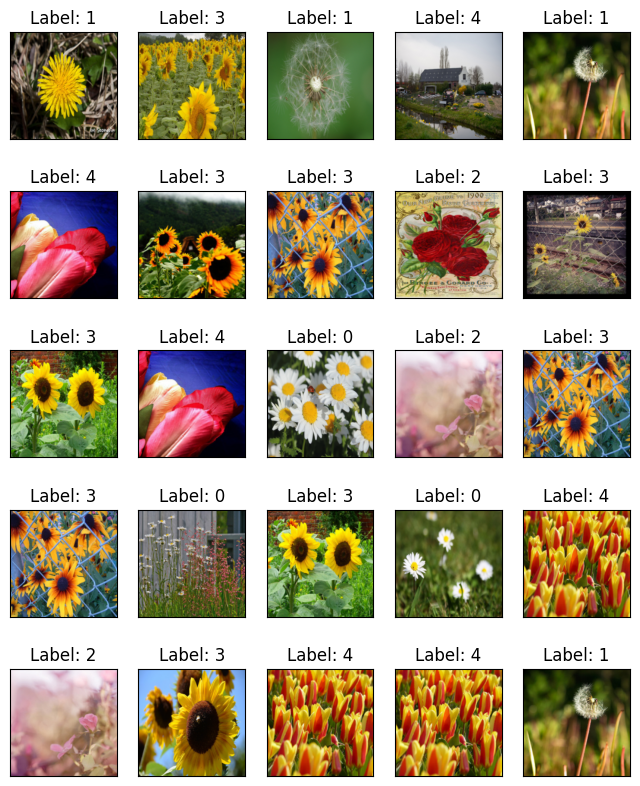

In [ ]:
#Printing a random subset of training dataset along with the labels
for images, labels in train_loader:
  fig, ax = plt.subplots(nrows=5, ncols=5, figsize=(8,10))
  for i in range(5):
    for j in range(5):
      idx = np.random.randint(images.shape[0])
      ax[i,j].set_title(f'Label: {labels[idx]}')
      ax[i,j].imshow(images[idx].permute(1, 2, 0))
      ax[i,j].axes.yaxis.set_visible(False)
      ax[i,j].axes.xaxis.set_visible(False)
  break

In [ ]:
# Utility function to train the model
def fit(num_epochs, model, loss_fn, opt, train_dl, test_dl, queue=None, device='cpu'):


    loss_curve = list()
    start_time = time.time() #starting time of the training algorithm

    process_name = mp.current_process().name

    #each process should have its own SummaryWriter instance
    log_dir = "logs/" + process_name + '-' + datetime.datetime.now().strftime("%m.%d-%H:%M:%S")
    writer = SummaryWriter(log_dir)

    example_data, example_targets = next(iter(train_dl))

    writer.add_graph(model, example_data)

    # Repeat for given number of epochs
    for epoch in range(num_epochs):
        start_time_epoch = time.time() #starting time of the epoch

        model.train() #setup model for training. Some types of layers, like batch normalization or dropout, behave differently

        # Train with batches of data
        for xb, yb in train_dl:

            xb = xb.to(device)
            yb = yb.to(device)

            # 1. Generate predictions
            Y_hat = model(xb)

            # 2. Calculate loss
            loss = loss_fn(Y_hat, yb)

            # 3. Compute gradients
            loss.backward()

            # 4. Update parameters using gradients
            opt.step()

            # 5. Reset the gradients to zero
            opt.zero_grad()

            #Save loss function values

        loss_curve.append(loss.detach())

        #Computing accuracy on train and test datasets
        train_acc = accuracy(model, train_dl, device)
        test_acc = accuracy(model, test_dl, device)

        end_time_epoch = time.time() #end time of the epoch
        elapsed_time = end_time_epoch - start_time_epoch

        if epoch%2 == 0:
            print(f'Rank {process_name}, epoch: {epoch}, time_epoch: {elapsed_time:.2f}, '
            f'training_loss: {loss.detach():.2f}, training_accuracy: {train_acc:.2f}, test_accuracy: {test_acc:.2f}')

        #Traking scalars
        writer.add_scalar(tag='training_loss', scalar_value=loss.detach(), global_step=epoch)
        writer.add_scalar(tag='training_accuracy', scalar_value=train_acc, global_step=epoch)
        writer.add_scalar(tag='test_accuracy', scalar_value=test_acc, global_step=epoch)

        #The SummaryWriter automatically flushes the events to disk at regular intervals.
        writer.flush()

    writer.close() # Close the SummaryWriter

    #Retrieving loss data
    loss_curve = [tensor.item() for tensor in loss_curve]
    if queue is not None:
      queue.put(loss_curve)
    else:
      return loss_curve

def accuracy(model, data_loader, device='cpu'):

    correct_pred = 0
    n = 0

    model.eval() #setup model for evaluation

    with torch.no_grad():

        for X, y in data_loader:

            X = X.to(device)
            y = y.to(device)

            y_logits = model(X)
            _, y_hat = torch.max(y_logits, dim=1) #valid for multiclass problem

            n += y.size(0)
            correct_pred += (y_hat == y).sum().item()

    return correct_pred / n

In [ ]:
#Hyperparameters
num_classes = 5

num_epochs = 10 #maximum number of ephocs
lr = 0.01 #learning rate

#Defining model
model = torch.nn.Sequential(

    torch.nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding=1),
    torch.nn.ReLU(inplace=True),
    torch.nn.MaxPool2d(kernel_size=3, stride=3),
    torch.nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1),
    torch.nn.BatchNorm2d(32),
    torch.nn.ReLU(inplace=True),
    torch.nn.MaxPool2d(kernel_size=3, stride=3),
    torch.nn.Flatten(),
    torch.nn.Linear(in_features=20*20*32, out_features=512),
    torch.nn.BatchNorm1d(512), #Batch normalization layers are usually placed after convolutional layers or fully connected/dense layers, but before the nonlinear activation
    torch.nn.ReLU(inplace=True),
    torch.nn.Linear(in_features=512, out_features=num_classes),
    torch.nn.ReLU(inplace=True)

  )

state_dict = model.state_dict() #to save the original state of the model
state_dict_original = copy.deepcopy(state_dict)

loss = torch.nn.CrossEntropyLoss() #cross entropy loss between input logits and target
opt = torch.optim.SGD(
    model.parameters(),
    lr=lr, #learning rate
    momentum=0.1 #momentum factor
    )

In [ ]:
summary(model,(3,180,180))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 180, 180]             448
       BatchNorm2d-2         [-1, 16, 180, 180]              32
              ReLU-3         [-1, 16, 180, 180]               0
         MaxPool2d-4           [-1, 16, 60, 60]               0
            Conv2d-5           [-1, 32, 60, 60]           4,640
       BatchNorm2d-6           [-1, 32, 60, 60]              64
              ReLU-7           [-1, 32, 60, 60]               0
         MaxPool2d-8           [-1, 32, 20, 20]               0
           Flatten-9                [-1, 12800]               0
           Linear-10                  [-1, 512]       6,554,112
             ReLU-11                  [-1, 512]               0
           Linear-12                    [-1, 5]           2,565
             ReLU-13                    [-1, 5]               0
Total params: 6,561,861
Trainable param

## Training with a single worker/process

In [ ]:
%%time
loss_curve_single = fit(num_epochs, model, loss, opt, train_loader, test_loader)

Rank MainProcess, epoch: 0, time_epoch: 93.34, training_loss: 1.09, training_accuracy: 0.55, test_accuracy: 0.49
Rank MainProcess, epoch: 2, time_epoch: 93.23, training_loss: 0.68, training_accuracy: 0.61, test_accuracy: 0.46
Rank MainProcess, epoch: 4, time_epoch: 92.26, training_loss: 0.85, training_accuracy: 0.68, test_accuracy: 0.54
Rank MainProcess, epoch: 6, time_epoch: 93.94, training_loss: 0.54, training_accuracy: 0.82, test_accuracy: 0.55
Rank MainProcess, epoch: 8, time_epoch: 94.70, training_loss: 0.60, training_accuracy: 0.93, test_accuracy: 0.61
CPU times: user 9min 24s, sys: 4min 37s, total: 14min 2s
Wall time: 15min 33s


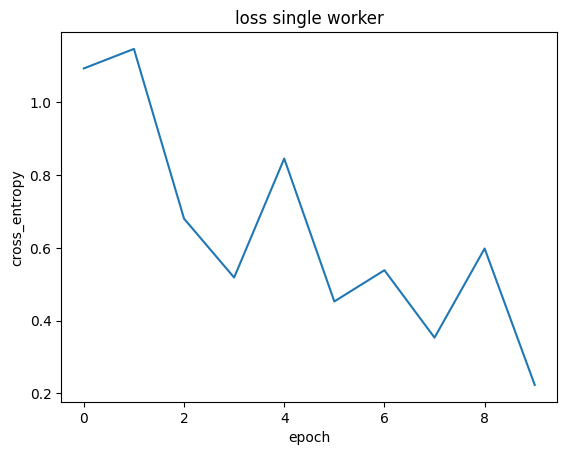

In [ ]:
plt.plot(loss_curve_single)
plt.xlabel('epoch')
plt.ylabel('cross_entropy')
plt.title('loss single worker')
plt.show()

In [ ]:
state_dict_trained = model.state_dict()

In [ ]:
#Final accuracy on test data
print('Final accuracy on test data:',accuracy(model, test_loader))

Final accuracy on test data: 0.5953678474114441


## Training with multiple workers/process

The parallelization of the training involves creating replicas of the model and processing different batches of data in parallel across the replicas.
The gradients on the replicas are aggregated using Ring-AllReduce algorithm, overlapping gradient computation with communication. The gradients are synchronized periodically to update the model's parameters consistently.  That is, after each training steps, all the replicas are the same.

Linux, when you start a child process, it is Forked. It means that the child process inherits the memory state of the parent process. On Windows (and by default on Mac), however, processes are Spawned. It means that a new interpreter starts and the code reruns.

In [ ]:
#Reset the parameters of the new model
model.load_state_dict(state_dict_original)

<All keys matched successfully>

In [ ]:
#Checking that the model parameters were reset
accuracy(model, test_loader)

0.19754768392370572

model.share_memory() method helps to allocate shared memory for the model parameters so that they can be accessed by multiple processes.

In [ ]:
model.share_memory()

Sequential(
  (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  (3): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (5): ReLU(inplace=True)
  (6): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  (7): Flatten(start_dim=1, end_dim=-1)
  (8): Linear(in_features=12800, out_features=512, bias=True)
  (9): ReLU(inplace=True)
  (10): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): Linear(in_features=512, out_features=5, bias=True)
  (12): ReLU(inplace=True)
)

In [ ]:
%%time

num_processes = 2
num_epochs_ = int(num_epochs/num_processes)

# Create a list of processes and start each process with the fit function
processes = []

queue = mp.Queue()

for rank in range(num_processes):

  p = mp.Process(target=fit, args =(num_epochs_, model, loss, opt, train_loader, test_loader, queue), name=f'Process-{rank}')

  p.start() #starts the process

  processes.append(p)

  print(f'Started {p.name}')

# Wait for all processes to finish
for p in processes:
  p.join()
  print(f'Finished {p.name}')

loss_curves = list()
for _ in range(num_processes):
  loss_curve = queue.get(timeout=30)
  loss_curves.append(loss_curve)

Started Process-0
Started Process-1
Rank Process-1, epoch: 0, time_epoch: 172.35, training_loss: 0.99, training_accuracy: 0.67, test_accuracy: 0.61
Rank Process-0, epoch: 0, time_epoch: 173.84, training_loss: 0.74, training_accuracy: 0.67, test_accuracy: 0.61
Rank Process-1, epoch: 2, time_epoch: 172.02, training_loss: 0.80, training_accuracy: 0.69, test_accuracy: 0.51
Rank Process-0, epoch: 2, time_epoch: 172.81, training_loss: 0.38, training_accuracy: 0.69, test_accuracy: 0.51
Rank Process-0, epoch: 4, time_epoch: 167.74, training_loss: 0.55, training_accuracy: 0.90, test_accuracy: 0.60
Finished Process-0
Rank Process-1, epoch: 4, time_epoch: 169.44, training_loss: 0.24, training_accuracy: 0.90, test_accuracy: 0.60
Finished Process-1
CPU times: user 3.74 s, sys: 663 ms, total: 4.41 s
Wall time: 14min 20s


In [ ]:
# Final accuracy on test data
print('Final accuracy on test data:',accuracy(model, test_loader))

Final accuracy on test data: 0.6049046321525886


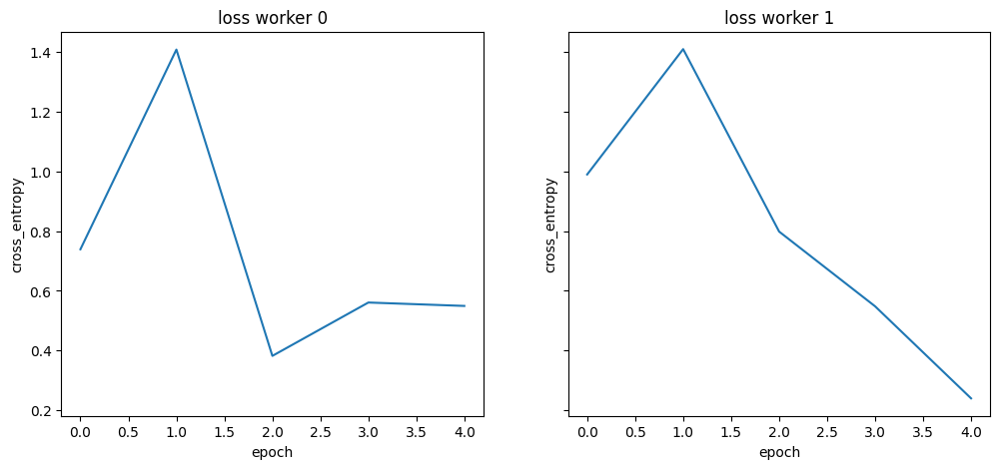

In [ ]:
loss_curve_0, loss_curve_1 = loss_curves

fig, (ax1,ax2) = plt.subplots(nrows=1,ncols=2, figsize=(12,5), sharey=True)

ax1.plot(loss_curve_0)

ax2.plot(loss_curve_1)

ax1.set_title('loss worker 0')
ax1.set_xlabel('epoch')
ax1.set_ylabel('cross_entropy')

ax2.set_title('loss worker 1')
ax2.set_xlabel('epoch')
ax2.set_ylabel('cross_entropy')

plt.show()

**Conclusion**: The parallelization of the process neither increased the final performance of the model nor speeded up the training procedure. When using two processes, the epochs took almost double the time to complete, preventing any gain in time.

## Visualization in Tensorboard

**Tensorboard** is a tool for monitoring machine learning algorithms provided by TensorFlow. It let you log PyTorch models and metrics into a directory for visualization within the TensorBoard UI.

In [ ]:
#Printing log files available

folder_path = 'logs'
for i, subfolder in enumerate(os.listdir(folder_path)):
  subfolder_path = os.path.join(folder_path, subfolder)
  print(i, subfolder_path)

0 logs/Process-1-07.09-15:42:37
1 logs/MainProcess-07.09-15:21:57
2 logs/MainProcess-07.09-15:01:47
3 logs/Process-0-07.09-15:42:37
4 logs/MainProcess-07.09-14:50:53


TensorBoard provides a web-based interface where you can view and analyze your experiment's data.

In [ ]:
# Jupyter magic command that allows you to load and enable the TensorBoard extension within a Jupyter notebook
%load_ext tensorboard

### Single worker performance

In [ ]:
#Launching the TensorBoard web interface using the specified log directory where TensorBoard events are stored

%tensorboard --logdir='logs/MainProcess-07.09-11:40:52' --port=6006

#Default port of tensorboard is 6006

<IPython.core.display.Javascript object>

In [ ]:
#To identify the process using the port
!lsof -i :6006

In [ ]:
#To terminate the process using the port
!kill 15436

### Multiple worker performance

In [ ]:
%tensorboard --logdir='logs/Process-0-07.09-12:00:45' --port=8000

<IPython.core.display.Javascript object>

In [ ]:
%tensorboard --logdir='logs/Process-1-07.09-12:00:45' --port=8008

<IPython.core.display.Javascript object>

Visualization model accuracy

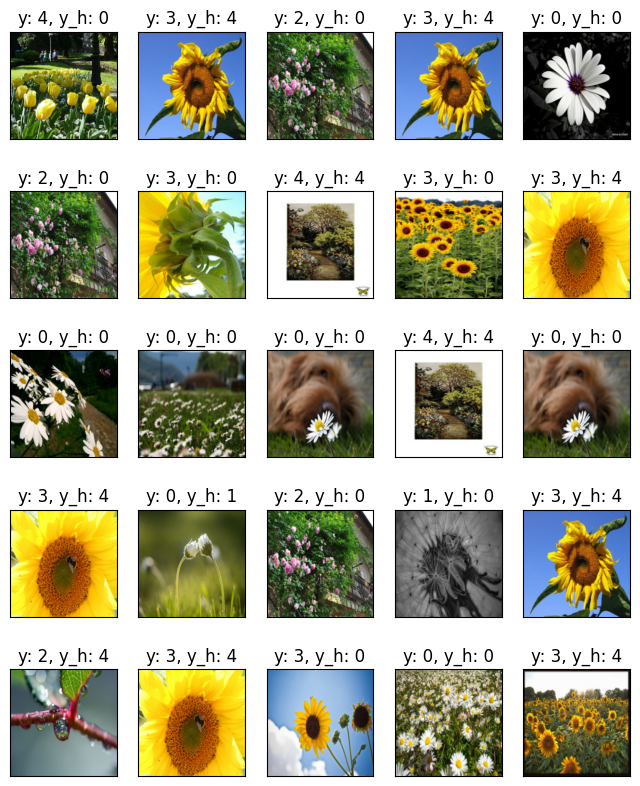

In [ ]:
for images, labels in test_loader:
  model.cpu()
  y_logits = model(images)
  _, y_hat = torch.max(y_logits, 1)

  fig, ax = plt.subplots(nrows=5, ncols=5, figsize=(8,10))
  for i in range(5):
    for j in range(5):
      idx = np.random.randint(images.shape[0])
      ax[i,j].set_title(f'y: {labels[idx]}, y_h: {y_hat[idx]}')
      ax[i,j].imshow(images[idx].permute(1, 2, 0))
      ax[i,j].axes.yaxis.set_visible(False)
      ax[i,j].axes.xaxis.set_visible(False)
  break